# Import Libraries

In [22]:
%pip install gensim
%pip install kaggle
%pip install textblob
%pip install pyspellchecker
%pip install fuzzywuzzy
%pip install python-Levenshtein
import pandas as pd
import numpy as np
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import re
from gensim.models import Word2Vec
from spellchecker import SpellChecker
from textblob import TextBlob
from fuzzywuzzy import fuzz
from fuzzywuzzy import process
import glob
import spacy
nlp = spacy.load('en_core_web_sm')
from nltk.corpus import stopwords
import string
from collections import Counter
from collections import OrderedDict
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.porter import *
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\malak\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\malak\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\malak\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\malak\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# Importing dataset


In [23]:
!mkdir ~/.kaggle
!move kaggle.json C:\Users\malak\.kaggle.

The syntax of the command is incorrect.
The system cannot find the file specified.


In [24]:
!kaggle datasets download -d notshrirang/spotify-million-song-dataset

spotify-million-song-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [25]:
# %unzip spotify-million-song-dataset.zip

In [26]:
spotifyDF = pd.read_csv("spotify_millsongdata.csv")

# Data Exploration

In [27]:
spotifyDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57650 entries, 0 to 57649
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   artist  57650 non-null  object
 1   song    57650 non-null  object
 2   link    57650 non-null  object
 3   text    57650 non-null  object
dtypes: object(4)
memory usage: 1.8+ MB


In [28]:
spotifyDF.columns

Index(['artist', 'song', 'link', 'text'], dtype='object')

In [29]:
spotifyDF.head(10)

,artist,song,link,text
0,ABBA,Ahe's My Kind Of Girl,/a/abba/ahes+my+kind+of+girl_20598417.html,"Look at her face, it's a wonderful face \r\nA..."
1,ABBA,"Andante, Andante",/a/abba/andante+andante_20002708.html,"Take it easy with me, please \r\nTouch me gen..."
2,ABBA,As Good As New,/a/abba/as+good+as+new_20003033.html,I'll never know why I had to go \r\nWhy I had...
3,ABBA,Bang,/a/abba/bang_20598415.html,Making somebody happy is a question of give an...
4,ABBA,Bang-A-Boomerang,/a/abba/bang+a+boomerang_20002668.html,Making somebody happy is a question of give an...
5,ABBA,Burning My Bridges,/a/abba/burning+my+bridges_20003011.html,"Well, you hoot and you holler and you make me ..."
6,ABBA,Cassandra,/a/abba/cassandra_20002811.html,Down in the street they're all singing and sho...
7,ABBA,Chiquitita,/a/abba/chiquitita_20002978.html,"Chiquitita, tell me what's wrong \r\nYou're e..."
8,ABBA,Crazy World,/a/abba/crazy+world_20003013.html,I was out with the morning sun \r\nCouldn't s...
9,ABBA,Crying Over You,/a/abba/crying+over+you_20177611.html,I'm waitin' for you baby \r\nI'm sitting all ...


In [30]:
spotifyDF.nunique()

artist      643
song      44824
link      57650
text      57494
dtype: int64

In [31]:
spotifyDF.song.value_counts()

song
Have Yourself A Merry Little Christmas    35
Angel                                     28
Hold On                                   27
Home                                      27
I Believe                                 26
                                          ..
Just Be Good (Bushman Dub)                 1
Kingston Town                              1
Kiss And Say Goodbye                       1
Lambsbread                                 1
Generation                                 1
Name: count, Length: 44824, dtype: int64

In [32]:
spotifyDF.text.value_counts()

text
I just came back from a lovely trip along the Milky Way  \r\nStopped off at the North Pole to spend a holiday  \r\nI called on dear old Santa Claus  \r\nTo see what I could see  \r\nHe took me to his workshop  \r\nAnd told his plans to me, so  \r\n  \r\n[Chorus]  \r\nYou better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\nHe's making a list and checking it twice  \r\nGonna find out who's naughty and nice  \r\nSanta Claus is comin' to town  \r\nHe sees you when you're sleepin'  \r\nHe knows when you're a wake  \r\nHe knows if you've been bad or good  \r\nSo be good for goodness sake  \r\nOh! You better watch out, you better not cry  \r\nBetter not pout, I'm telling you why  \r\nSanta Claus is comin' to town  \r\n  \r\nWith little tin horns and little toy drums  \r\nRooty toot toots and rummy tum tums  \r\nSanta Claus is comin' to town  \r\nAnd curly head dolls that toddle and coo  \r\nElephants, boats, and kiddie ca

# Data Cleaning

## Remove null values

In [33]:
spotifyDFCopy=spotifyDF.copy()

In [34]:
spotifyDFCopy.isnull().mean()*100

artist    0.0
song      0.0
link      0.0
text      0.0
dtype: float64

No null values are present in the dataset

##  Remove Full row duplicates

In [35]:
spotifyDFCopy.duplicated().sum()

0

No full row duplicates are present in the dataset

## Tokenization and Lemmatization

In [36]:
def dataframe_to_texts(df):
    texts = df['text'].tolist()
    return texts

In [37]:
texts=dataframe_to_texts(spotifyDFCopy)

In [38]:
token_list=[]
from nltk.tokenize import word_tokenize
token_list = [word_tokenize(text) for text in texts]
token_list

[['Look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonderful',
  'face',
  'And',
  'it',
  'means',
  'something',
  'special',
  'to',
  'me',
  'Look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smiles',
  'when',
  'she',
  'sees',
  'me',
  'How',
  'lucky',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'makes',
  'me',
  'feel',
  'fine',
  'Who',
  'could',
  'ever',
  'believe',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'She',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'I',
  "'m",
  'blue',
  'And',
  'if',
  'she',
  'ever',
  'leaves',
  'me',
  'what',
  'could',
  'I',
  'do',
  ',',
  'what',
  'could',
  'I',
  'do',
  '?',
  'And',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'And',
  'she',
  'holds',
  'me',
  'and',
  'squeezes',
  'my',
  'hand',
  'We',
  "'ll",
  'go',
 

In [39]:
p_stemmer = PorterStemmer()

def tokenize_column(array):
    nltk_stemedList = []
    for array in token_list:
        nltk_stem=[]
        for word in array:
            nltk_stem.append(p_stemmer.stem(word))
        nltk_stemedList.append(nltk_stem)
    return nltk_stemedList

In [40]:
stemmed_list=[]
stemmed_list=tokenize_column(token_list)
stemmed_list

[['look',
  'at',
  'her',
  'face',
  ',',
  'it',
  "'s",
  'a',
  'wonder',
  'face',
  'and',
  'it',
  'mean',
  'someth',
  'special',
  'to',
  'me',
  'look',
  'at',
  'the',
  'way',
  'that',
  'she',
  'smile',
  'when',
  'she',
  'see',
  'me',
  'how',
  'lucki',
  'can',
  'one',
  'fellow',
  'be',
  '?',
  'she',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'she',
  'make',
  'me',
  'feel',
  'fine',
  'who',
  'could',
  'ever',
  'believ',
  'that',
  'she',
  'could',
  'be',
  'mine',
  '?',
  'she',
  "'s",
  'just',
  'my',
  'kind',
  'of',
  'girl',
  ',',
  'without',
  'her',
  'i',
  "'m",
  'blue',
  'and',
  'if',
  'she',
  'ever',
  'leav',
  'me',
  'what',
  'could',
  'i',
  'do',
  ',',
  'what',
  'could',
  'i',
  'do',
  '?',
  'and',
  'when',
  'we',
  'go',
  'for',
  'a',
  'walk',
  'in',
  'the',
  'park',
  'and',
  'she',
  'hold',
  'me',
  'and',
  'squeez',
  'my',
  'hand',
  'we',
  "'ll",
  'go',
  'on',
  'walk',

## Stop words removal

In [41]:
def remove_stop_words(token_list):
    no_stop_words_final = []
    for word_array in token_list:
        no_stop_words = []
        for word in word_array:
            if not nlp.vocab[word].is_stop:
                no_stop_words.append(word)
        no_stop_words_final.append(no_stop_words)
    return no_stop_words_final

In [42]:
no_stop_words=[]
no_stop_words=remove_stop_words(stemmed_list)
no_stop_words

[['look',
  'face',
  ',',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  '?',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leav',
  ',',
  '?',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  ',',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  ',',
  'blue',
  'leav',
  ',',
  '?'],
 ['easi',
  ',',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  ',',
  'slow',
  'andant',
  ',',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  ',',
  'know',
  'andant',
  ',',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong'

## Remove Punctuation

In [43]:
punctuations="?:!.,;"
def remove_punctuation(no_stop_words):
    for array_with_stop_words in no_stop_words:
        for word in array_with_stop_words:
            if word in punctuations:
                array_with_stop_words.remove(word)
    return no_stop_words

In [44]:
no_punctuations=[]
no_punctuations=remove_punctuation(no_stop_words)
no_punctuations

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong',
  ')',
  'sing',
  'sound',
  '(',
  'sing',
  ')',
  'andant',
  'andant',
  'tread',
  'lightli',
  '

## Spell checker

In [45]:
# spell = SpellChecker()
# def correct_spell(no_punctuations):
#     corrected_textfinal = []
#     for array in no_punctuations:
#         corrected_text=[]
#         for word in array:
#             correct=spell.correction(word)
#             if(correct is not None):
#                 corrected_text.append(correct)
#         corrected_textfinal.append(corrected_text)
#     return corrected_textfinal

In [46]:
# correct_spelling=[]
# correct_spelling=correct_spell(no_punctuations)
# correct_spelling

## Lower Case the words

In [47]:
def lower_case(correct_spelling):
    lower_case_final = []
    for array in correct_spelling:
        lower_case = []
        for word in array:
            lower_case.append(word.lower())
        lower_case_final.append(lower_case)
    return lower_case_final

In [48]:
adjusted_DF=[]
adjusted_DF=lower_case(no_punctuations)
adjusted_DF

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong',
  ')',
  'sing',
  'sound',
  '(',
  'sing',
  ')',
  'andant',
  'andant',
  'tread',
  'lightli',
  '

## Removing extra lines (\n)

In [49]:
def remove_n(adjusted_DF):
    for array in adjusted_DF:
        for word in array:
            if word.startswith(' \r\n'):
                array.remove(word)
            if word.startswith('\r\n'):
                array.remove(word)
    return adjusted_DF


In [50]:
final_DF_after_cleaning=[]
final_DF_after_cleaning=remove_n(adjusted_DF)
final_DF_after_cleaning

[['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong',
  ')',
  'sing',
  'sound',
  '(',
  'sing',
  ')',
  'andant',
  'andant',
  'tread',
  'lightli',
  '

In [51]:
spotifyDFCopy['text_cleaned'] = final_DF_after_cleaning

# Data Analysis

## Term, Document Frequencies

In [52]:
def generate_vocab(array_of_arrays):
    tokens_set = set(token for word_array in array_of_arrays for token in word_array)
    vocab = list(tokens_set)
    return vocab

In [53]:
vocab = generate_vocab(final_DF_after_cleaning)
print(vocab)

['ictibu', 'persa', "kissed'em", 'skuller', 'j.', 'menageri', 'panini', 'story-', 'bichhaan', 'madraykin', 'ilusion', 'coleman', 'ingl', 'lid', 'loose-lip-woman', 'car-key', 'heather', "anch'io", 'enamabala', 'greenish', 'phil', 'lofi', 'hayu', 'kapansin-pansin', 'danji', 'ena', 'tief', 'templ', 'slippin', 'carrie-ann', 'oiju', 'canalop', 'valueless', 'nuit-nuit', 'landi', 'missl', 'bblblblblblblbl', 'freshmen', 'galipolli', 'wazato', 'malden', 'uh-uh-hey', 'hakayam', '2033', 'bond', 'intro', "o'clock-in-the-morn", 'pasar', 'infomerci', 'azalea', 'eastsid', 'jak', 'biller', 'wierdi', 'dubya', 'vede', 'listenin', 'taco', 'koobi', 'kooki', 'beondo', 'braincel', 'yup', 'goin', 'wierd', 'monstrou', 'sade', 'judism', 'toora', 'soi-tainly.', "'mom", 'he-he-hey', 'ingrain', 'laidi', 'nazarein', 'oooey', 'criss', 'salam', 'pittery-pat', 'ihnen', "ba'amat", 'butcherman', 'teacheth', 'wheresi', 'daman', 'pattern', 'ataci', 'fetter', 'hir', 'addida', 'fa-la-la-la-lah', 'tawagin', 'quitan', 'jee',

In [54]:
dictionary = {}
for i, array in enumerate(final_DF_after_cleaning):
    dictionary[i] = array

In [55]:
dictionary

{0: ['look',
  'face',
  'wonder',
  'face',
  'mean',
  'someth',
  'special',
  'look',
  'way',
  'smile',
  'lucki',
  'fellow',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  'kind',
  'girl',
  'blue',
  'leav',
  'walk',
  'park',
  'hold',
  'squeez',
  'hand',
  'walk',
  'hour',
  'talk',
  'thing',
  'plan',
  'kind',
  'girl',
  'feel',
  'fine',
  'believ',
  '?',
  'kind',
  'girl',
  'blue',
  'leav',
  '?'],
 1: ['easi',
  'pleas',
  'touch',
  'gentli',
  'like',
  'summer',
  'breez',
  'time',
  'slow',
  'andant',
  'andant',
  'let',
  'feel',
  'grow',
  'finger',
  'soft',
  'light',
  'let',
  'bodi',
  'velvet',
  'night',
  'touch',
  'soul',
  'know',
  'andant',
  'andant',
  'slowli',
  'music',
  '(',
  'music',
  'song',
  ')',
  'song',
  '(',
  'music',
  'song',
  ')',
  'play',
  'time',
  'time',
  'strong',
  '(',
  'play',
  "'caus",
  'strong',
  ')',
  'sing',
  'sound',
  '(',
  'sing',
  ')',
  'andant',
  'andant',
  'tread',
  'lightli

## Most Frequent Class

In [56]:
spotifyDFCopy['artist'].value_counts().head(10)

artist
Donna Summer        191
Gordon Lightfoot    189
Bob Dylan           188
George Strait       188
Loretta Lynn        187
Cher                187
Alabama             187
Reba Mcentire       187
Chaka Khan          186
Dean Martin         186
Name: count, dtype: int64

## Frequency of songs per artist

In [57]:
import matplotlib.pyplot as plt

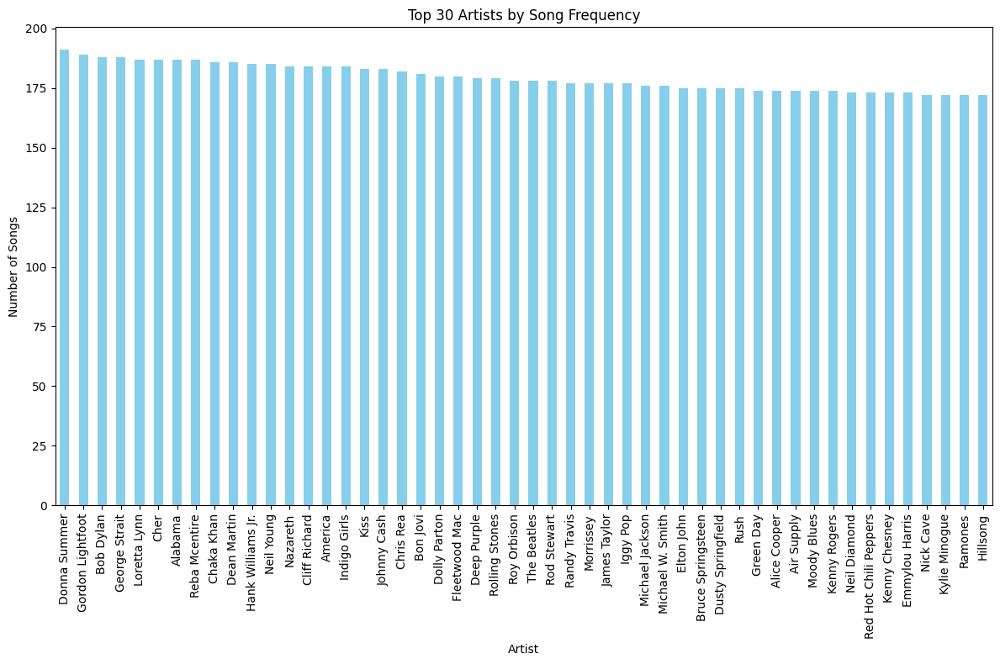

In [58]:
artist_song_freq = spotifyDFCopy['artist'].value_counts().nlargest(50)
plt.figure(figsize=(12, 8))
artist_song_freq.plot(kind='bar', color='skyblue')
plt.title('Top 30 Artists by Song Frequency')
plt.xlabel('Artist')
plt.ylabel('Number of Songs')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## Words in lyrics per song

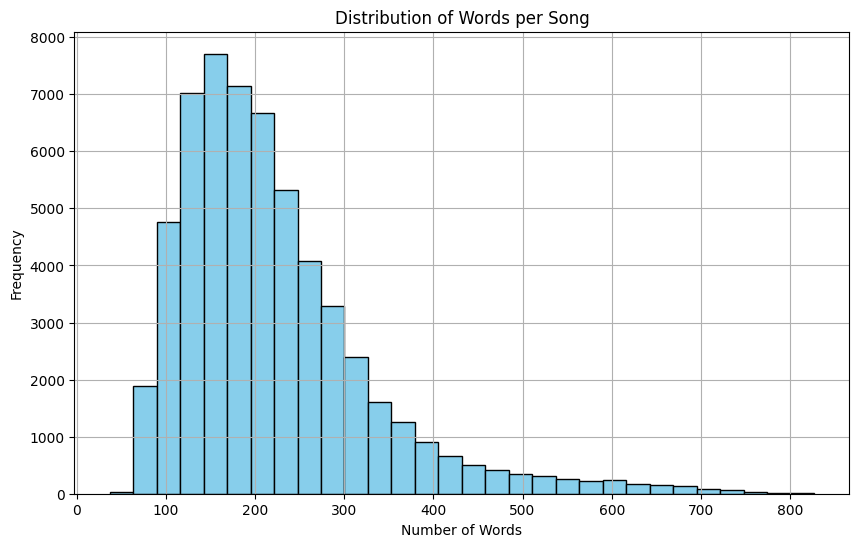

In [59]:
word_counts = []
for lyrics in spotifyDFCopy['text']:
    word_count = len(lyrics.split())
    word_counts.append(word_count)

plt.figure(figsize=(10, 6))
plt.hist(word_counts, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Words per Song')
plt.xlabel('Number of Words')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

## Repetition of words in a song

In [60]:
from collections import Counter

def calculate_repetition_scores(songs_lemmatized):
    repetition_scores = []
    for song_lyrics in songs_lemmatized:
        stem_counts = Counter(song_lyrics)
        unique_stems = len(stem_counts)
        total_stems = sum(stem_counts.values())
        repetition_score = unique_stems / total_stems if total_stems > 0 else 0
        repetition_scores.append(repetition_score)
    return repetition_scores


In [61]:
repetition_scores = calculate_repetition_scores(final_DF_after_cleaning)
print("Repetition Scores:", repetition_scores)

Repetition Scores: [0.6428571428571429, 0.33076923076923076, 0.3945578231292517, 0.48936170212765956, 0.48936170212765956, 0.8541666666666666, 0.569620253164557, 0.4609375, 0.5982905982905983, 0.3548387096774194, 0.3916083916083916, 0.48936170212765956, 0.7017543859649122, 0.3875968992248062, 0.43434343434343436, 0.40625, 0.5529411764705883, 0.3409090909090909, 0.6666666666666666, 0.4177215189873418, 0.851063829787234, 0.5051546391752577, 0.38686131386861317, 0.38, 0.3333333333333333, 0.8181818181818182, 0.6951219512195121, 0.48214285714285715, 0.4215686274509804, 0.43790849673202614, 0.5634920634920635, 0.3114754098360656, 0.3626943005181347, 0.36764705882352944, 0.45977011494252873, 0.4334763948497854, 0.40384615384615385, 0.37662337662337664, 0.6027397260273972, 0.4358974358974359, 0.6567164179104478, 0.6376811594202898, 0.2824074074074074, 0.4824561403508772, 0.6176470588235294, 0.27413127413127414, 0.8333333333333334, 0.5517241379310345, 0.36879432624113473, 0.29310344827586204, 0

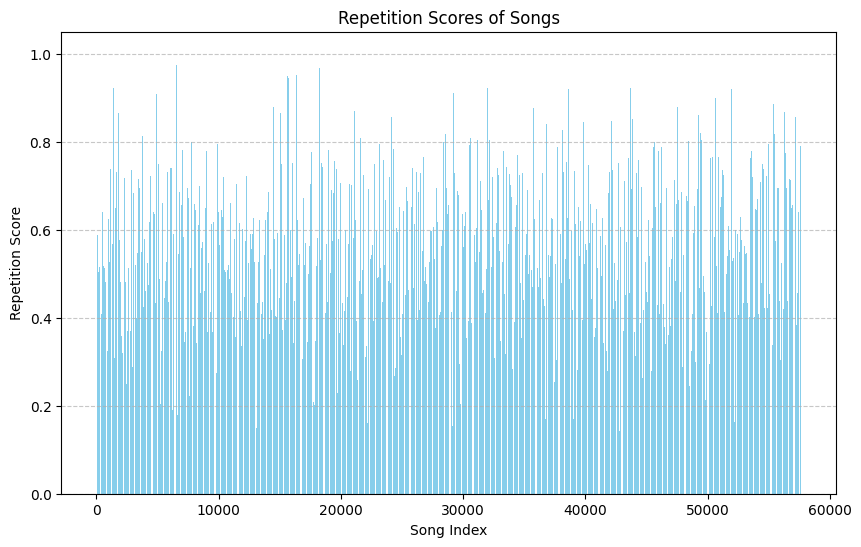

In [62]:
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(repetition_scores) + 1), repetition_scores, color='skyblue')
plt.xlabel('Song Index')
plt.ylabel('Repetition Score')
plt.title('Repetition Scores of Songs')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

## TF-IDF Calculation

### TF Calculation

In [63]:
def calculate_tf_docs(documents):
    tf_docs = {}
    index = 0
    for doc in documents:
        tf_docs[index] = {}
        for word in doc:
            if word in tf_docs[index]:
                tf_docs[index][word] += 1
            else:
                tf_docs[index][word] = 1
        tf_docs[index] = dict(sorted(tf_docs[index].items(), key=lambda item: item[1], reverse=True))
        index += 1
    return tf_docs

In [64]:
tf_docs = calculate_tf_docs(final_DF_after_cleaning)
tf_docs

{0: {'kind': 4,
  'girl': 4,
  'look': 2,
  'face': 2,
  'feel': 2,
  'fine': 2,
  'believ': 2,
  'blue': 2,
  'leav': 2,
  'walk': 2,
  '?': 2,
  'wonder': 1,
  'mean': 1,
  'someth': 1,
  'special': 1,
  'way': 1,
  'smile': 1,
  'lucki': 1,
  'fellow': 1,
  'park': 1,
  'hold': 1,
  'squeez': 1,
  'hand': 1,
  'hour': 1,
  'talk': 1,
  'thing': 1,
  'plan': 1},
 1: {'andant': 20,
  '(': 9,
  ')': 9,
  'let': 7,
  'pleas': 6,
  'music': 6,
  'song': 6,
  'sing': 6,
  'time': 5,
  'play': 5,
  'strong': 4,
  'oh': 4,
  'sound': 3,
  'tread': 3,
  'lightli': 3,
  'ground': 3,
  'touch': 2,
  'like': 2,
  'feel': 2,
  "'caus": 2,
  'easi': 1,
  'gentli': 1,
  'summer': 1,
  'breez': 1,
  'slow': 1,
  'grow': 1,
  'finger': 1,
  'soft': 1,
  'light': 1,
  'bodi': 1,
  'velvet': 1,
  'night': 1,
  'soul': 1,
  'know': 1,
  'slowli': 1,
  'shimmer': 1,
  'eye': 1,
  'thousand': 1,
  'butterfli': 1,
  'talk': 1,
  'float': 1,
  'away': 1,
  ',': 1},
 2: {'ma': 32,
  'new': 11,
  'good': 9,


### DF Calculation

In [67]:
def calculate_df(documents):
    df = {}
    for doc in documents:
        unique_terms = set(doc)
        for term in unique_terms:
            if term in df:
                df[term] += 1
            else:
                df[term] = 1
    df = dict(sorted(df.items(), key=lambda item: item[1], reverse=True))
    return df

In [69]:
df = calculate_df(final_DF_after_cleaning)
df

{'know': 28253,
 'love': 26087,
 'like': 23755,
 'thi': 22674,
 'time': 21417,
 'come': 19778,
 'got': 19751,
 "'": 18061,
 'wa': 17779,
 'way': 16679,
 'oh': 16460,
 'want': 16392,
 'feel': 16137,
 'day': 15178,
 'let': 14874,
 'heart': 14251,
 'look': 13985,
 'night': 13344,
 'life': 13250,
 'na': 13163,
 'away': 12845,
 'thing': 12548,
 'right': 12176,
 'tell': 12085,
 'eye': 12040,
 'need': 11861,
 'think': 11776,
 ')': 11757,
 '(': 11752,
 'babi': 11450,
 'world': 10428,
 'onli': 10401,
 'tri': 10333,
 'man': 10325,
 'live': 10269,
 'gon': 10255,
 'yeah': 9690,
 'find': 9306,
 'long': 9236,
 'dream': 9193,
 'good': 9177,
 'littl': 8997,
 'everi': 8996,
 'said': 8973,
 'mind': 8903,
 'turn': 8879,
 '[': 8681,
 ']': 8681,
 'wo': 8666,
 'hand': 8638,
 "'caus": 8607,
 'whi': 8541,
 'choru': 8352,
 'hi': 8332,
 'girl': 8296,
 'light': 8087,
 'alway': 8004,
 ',': 7998,
 'hear': 7919,
 'ai': 7868,
 'hold': 7855,
 'leav': 7675,
 'home': 7661,
 'walk': 7606,
 'face': 7506,
 'head': 7150,
 

### IDF Calculation

In [71]:
import math

In [72]:
def calculate_idf(documents):
    N = len(documents)
    df = {}
    idf = {}
    for doc in documents:
        unique_terms = set(doc)
        for term in unique_terms:
            if term in df:
                df[term] += 1
            else:
                df[term] = 1

    for term, freq in df.items():
        idf[term] = 1 + math.log10(N / freq)

    return idf

In [73]:
idf = calculate_idf(final_DF_after_cleaning)
idf

{'hour': 2.4922213397478745,
 'girl': 1.8419305682497331,
 'park': 2.8453994764184483,
 'mean': 2.128139598336804,
 'wonder': 2.178735948719009,
 'way': 1.5386293029489526,
 'kind': 2.261112229012314,
 'squeez': 3.2057048630523988,
 'feel': 1.55297651262921,
 'believ': 1.9598761298174994,
 'hold': 1.8656531222547257,
 'plan': 2.509647968455363,
 'walk': 1.8796429905551542,
 'look': 1.6151368409231717,
 'leav': 1.8757209274814937,
 'special': 2.8438192643103357,
 '?': 2.503600885491373,
 'blue': 2.1001235232921935,
 'someth': 1.9778969056560731,
 'face': 1.885390751553654,
 'smile': 2.0895338786835596,
 'thing': 1.6622248016050105,
 'lucki': 2.8909811036513897,
 'hand': 1.8243861119192382,
 'talk': 2.045883063637133,
 'fellow': 3.551284297088087,
 'fine': 2.380045540826818,
 'know': 1.3097347421559347,
 'sing': 2.058196470290291,
 'thousand': 2.6259849413102576,
 'float': 2.973338837112303,
 'butterfli': 3.3645999645349813,
 'away': 1.6520652030283527,
 'lightli': 3.9478859549878624,
 '

### TF-IDF Calculation

In [91]:
def calculate_tf_idf(tf_docs, idf):
    tf_idf_docs = {}
    for doc_id, tf_doc in tf_docs.items():
        tf_idf_doc = {}
        for term, tf in tf_doc.items():
            tf_idf_doc[term] = tf * idf.get(term, 0)
        tf_idf_docs[doc_id] = dict(sorted(tf_idf_doc.items(), key=lambda item: item[1], reverse=True))
    return tf_idf_docs

In [92]:
tf_idf_docs = calculate_tf_idf(tf_docs, idf)
tf_idf_docs

{0: {'kind': 9.044448916049255,
  'girl': 7.3677222729989325,
  '?': 5.007201770982746,
  'fine': 4.760091081653636,
  'blue': 4.200247046584387,
  'believ': 3.9197522596349987,
  'face': 3.770781503107308,
  'walk': 3.7592859811103083,
  'leav': 3.7514418549629873,
  'fellow': 3.551284297088087,
  'look': 3.2302736818463433,
  'squeez': 3.2057048630523988,
  'feel': 3.10595302525842,
  'lucki': 2.8909811036513897,
  'park': 2.8453994764184483,
  'special': 2.8438192643103357,
  'plan': 2.509647968455363,
  'hour': 2.4922213397478745,
  'wonder': 2.178735948719009,
  'mean': 2.128139598336804,
  'smile': 2.0895338786835596,
  'talk': 2.045883063637133,
  'someth': 1.9778969056560731,
  'hold': 1.8656531222547257,
  'hand': 1.8243861119192382,
  'thing': 1.6622248016050105,
  'way': 1.5386293029489526},
 1: {'andant': 115.21598623261437,
  '(': 15.216187759636659,
  ')': 15.214525140896576,
  'music': 14.277022131761353,
  'pleas': 12.571309923676589,
  'song': 12.439622102496502,
  'si